In [70]:
# Importing data from the r/politics
from psaw import PushshiftAPI
import datetime
import pandas as pd
import os
import re
import numpy as np
from tqdm import tqdm
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from nltk.corpus import stopwords
from nltk import word_tokenize
import string
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.dates as mdates
import requests
import io
import networkx as nx ; import netwulf as nw
from netwulf import visualize

In [44]:
url_sub = "https://raw.githubusercontent.com/JaQtae/SocInfo2022/FinalProject/Data/politics_subs_big_fully_processed.csv"

download_sub = requests.get(url_sub).content

sub_data = pd.read_csv(io.StringIO(download_sub.decode('utf-8')), parse_dates = ['dates'], sep=',').set_index('dates')


url_com = "https://raw.githubusercontent.com/JaQtae/SocInfo2022/FinalProject/Data/com_data_50plusComments_pruned_30plusComments.csv"

download_com = requests.get(url_com).content

com_data = pd.read_csv(io.StringIO(download_com.decode('utf-8')), parse_dates = ['dates'], sep=',').set_index('dates')

sub_data = sub_data[sub_data.index > "2020-10-01"]


sub_data = sub_data[sub_data.index >= "2020-10-01"]

sub_data_to_remove = sub_data[sub_data.index < "2020-10-01"]

ids_to_remove = list(sub_data_to_remove["id"].values)

comments_to_delete = list(set(ids_to_remove))
for i in range(len(comments_to_delete)): 
    comments_to_delete[i] = 't3_' + comments_to_delete[i]
comments_to_delete

for i in range(len(comments_to_delete)):
    com_index = com_data[com_data['link_id'] == comments_to_delete[i]].index
    com_data = com_data.drop(com_index)
    
com_data = com_data.drop(com_data[com_data['parent_author'] == 'PoliticsModeratorBot'].index)

    
# Make sure all text bodies are of type string. 
com_data["body"] = com_data["body"].apply(str)
com_data

,id,link_id,score,author,parent_id,body,parent_author,tokens,politician,children_comments,mentions_Trump,mentions_Biden
dates,,,,,,,,,,,,
2020-11-03 00:23:36,gaycvmz,t3_jmybs3,1,yyungpiss,t3_jmybs3,is there some sort of weird strategy to this o...,geoxol,"['sort', 'weird', 'strategy', 'something', 'la...",Trump,[],NaN,NaN
2020-11-02 23:26:26,gay6kwb,t3_jmybs3,1,J_Class_Ford,t1_gay5x5w,Division is his weapon,cyanydeez,"['division', 'weapon']",Trump,[],NaN,NaN
2020-11-02 23:20:27,gay5x5w,t3_jmybs3,1,cyanydeez,t1_gay5pjk,"dunno, everything trump does seems to generate...",J_Class_Ford,"['dunno', 'everything', 'trump', 'seems', 'gen...",Trump,['gay6kwb'],True,NaN
2020-11-02 23:18:33,gay5pjk,t3_jmybs3,1,J_Class_Ford,t1_gay5doq,Not sure it generates many more votes. I work ...,cyanydeez,"['not', 'sure', 'generates', 'many', 'votes', ...",Trump,['gay5x5w'],True,NaN
2020-11-02 23:15:36,gay5doq,t3_jmybs3,1,cyanydeez,t1_gay3si8,"yeah, but for every vote this generates, would...",J_Class_Ford,"['yeah', 'every', 'vote', 'generates', 'would'...",Trump,['gay5pjk'],NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-01 01:25:30,g78ozrz,t3_j2vwwt,1,5DollarHitJob,t3_j2vwwt,Can they just appeal this?,Plymouth03,"['can', 'appeal']",Trump,[],NaN,NaN
2020-10-01 01:24:25,g78ovcd,t3_j2vwwt,1,AmishTechno,t3_j2vwwt,"And, nothing will happen.",Plymouth03,"['and', 'nothing', 'happen']",Trump,[],NaN,NaN
2020-10-01 00:29:42,g78j6ey,t3_j2vwwt,1,ryhaltswhiskey,t1_g78iult,Ah I did not know that\n\nMan I hope Barr ends...,memepolizia,"['ah', 'i', 'know', 'man', 'i', 'hope', 'barr'...",Trump,[],NaN,NaN


### Statistics of the submissions

We'll look into the distribution of the submissions mentioning either Trump or Biden. 

findfont: Font family ['Helvetica Neue'] not found. Falling back to DejaVu Sans.


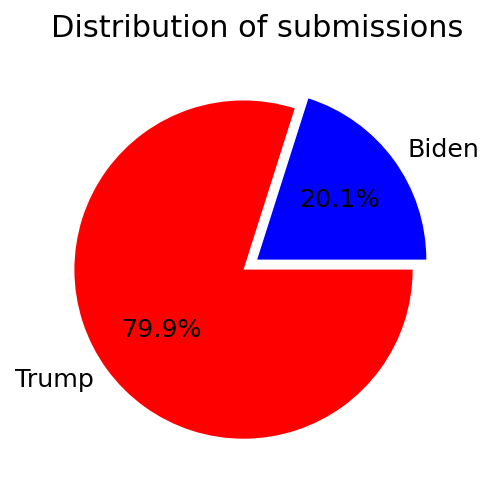

In [45]:
biden_trump_subs_dist = pd.DataFrame(sub_data.groupby("politician").count()["title"])
biden_trump_subs_dist = biden_trump_subs_dist.rename(columns = {"title" : " "})
#biden_trump_subs_dist
fig = plt.figure(dpi=140)
subs_dist_plot = biden_trump_subs_dist.plot.pie(y = " ", title = "Distribution of submissions", legend = False, colors = ["blue", "red"], shadow = False, autopct='%1.1f%%', explode=(0, 0.1), ax=plt.gca())
subs_dist_plot.figure.savefig("subs_distribution.png")

In [46]:
print("Total number of submissions: " + str(len(sub_data)))
print("Total number of submissions mentioning Trump: " + str(len(sub_data.loc[sub_data["politician"] == "Trump"])))
print("Total number of submissions mentioning Biden: " + str(len(sub_data.loc[sub_data["politician"] == "Biden"])))
print("Number of unique authors: " + str(len(sub_data["author"].unique())))
print("Average number of submissions per author: " + str(round(sub_data.groupby("author").count()["title"].mean(),2)))
print("Average number of comments per submission: " + str(round(sub_data["num_comments"].mean(), 1)))

Total number of submissions: 9018
Total number of submissions mentioning Trump: 7205
Total number of submissions mentioning Biden: 1813
Number of unique authors: 2912
Average number of submissions per author: 3.1
Average number of comments per submission: 150.5


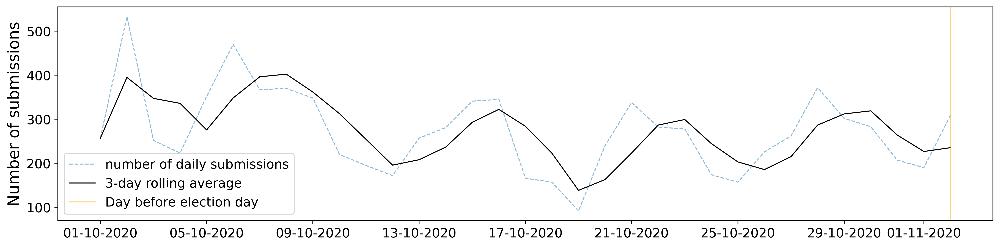

In [48]:
#We had some submissions befor the first of october
daily_subs = sub_data['id'].resample('D').count()
#Specifying the MatPlotLib font and line width
def setup_mpl():
    mpl.rcParams['font.family'] = 'Helvetica Neue'
    mpl.rcParams['font.size'] = '13'
    mpl.rcParams['lines.linewidth'] = 1
setup_mpl()
MyFmt = mdates.DateFormatter('%d-%m-%Y')
#Resample number of comments per day. 
#Convert to dataframe
daily_subs_df = pd.DataFrame(
                    {
                        'Daily submissions' : daily_subs.values
                    }, index = daily_subs.index)

MA_subs = daily_subs_df["Daily submissions"].rolling('3D').mean()
#Plot the moving average on top!

#fig, ax = plt.subplots(figsize=(15,5), dpi=400)
fig, ax = plt.subplots(figsize=(17,4), dpi=400)
ax.plot(daily_subs.index, daily_subs.values, ls = '--', alpha=0.5, label="number of daily submissions")
ax.plot(MA_subs.index, MA_subs.values, color='k', label="3-day rolling average")

ax.axvline(x=daily_subs.index[-1], label='Day before election day', color='orange', alpha=0.5)
#ax.plot(rolled_series.index, rolled_series.values, color='k', label="1 week rolling average")
ax.set_ylabel('Number of submissions', size = 16)
#ax.set_yscale('log')
ax.legend()
ax.xaxis.set_major_formatter(MyFmt)

plt.savefig('submissions_per_day_big.png', bbox_inches='tight')

In [49]:
sub_data[:3].drop(columns=["score"])

,title,id,author,num_comments,url,politician
dates,,,,,,
2020-11-02 22:54:58,Trump ramps up Fauci attacks on eve of electio...,jmybs3,geoxol,33,https://thehill.com/homenews/administration/52...,Trump
2020-11-02 22:48:58,Trump Loves To Declare Victory Even if He Didn...,jmy7vu,Facerealityalready,16,https://www.motherjones.com/politics/2020/11/t...,Trump
2020-11-02 22:46:57,Trump creates 1776 Commission to promote 'patr...,jmy6j9,bluestblue,53,https://www.politico.com/news/2020/11/02/trump...,Trump


### Statistics of the comments

# 3 Tools, theory and analysis

In [50]:
# Implementing the VADER sentiment analysis of the comments. 

#https://www.geeksforgeeks.org/python-sentiment-analysis-using-vader/
def calculate_compound_sentiment_score(sentence):

    # Create a SentimentIntensityAnalyzer object.
    sid_obj = SentimentIntensityAnalyzer()
 
    # polarity_scores method of SentimentIntensityAnalyzer
    # object gives a sentiment dictionary.
    # which contains pos, neg, neu, and compound scores.
    sentiment_dict = sid_obj.polarity_scores(sentence)
     
    # The Compound score is a metric that calculates the sum of all the lexicon ratings 
    # which have been normalized between -1(most extreme negative) and +1 (most extreme positive).   
    
    return sentiment_dict['compound']

In [51]:
tqdm.pandas()
com_data["compound_sentiment_score"] = com_data["body"].progress_apply(calculate_compound_sentiment_score)

100%|███████████████████████████████████████████████████████████████████████████| 95893/95893 [15:11<00:00, 105.15it/s]


In [52]:
test = com_data["body"][-2]
test = re.sub(r'\n', '', test)
test = re.sub(r'\'', '', test)
calculate_compound_sentiment_score('not bad good')
#test

0.1139

NOTE: Here, we've managed to delete even more comments leaving some authors with less than five comments. 

In [53]:
tqdm.pandas()
group = com_data.groupby(["author", "politician"])
#author_df_V = group.progress_apply(lambda x: x["compound_sentiment_score"].unique())


In [54]:
author_comments = group["body"].unique()
text = author_comments.values[0]

In [55]:
author_bodies = com_data.groupby(["author", "politician"]).apply(lambda x: x["body"].unique())

In [56]:
# Joining the comments for each politician for each of the authors
for i in tqdm(range(len(author_bodies.values))):
    author_bodies.values[i] = " ".join(list(author_bodies.values[i]))
    

100%|██████████████████████████████████████████████████████████████████████████| 3340/3340 [00:00<00:00, 119603.98it/s]


In [57]:
# List of unique comments authors
authors = list(com_data["author"].unique())

In [58]:
# Dict to contain the authors as keys and a dict as value: {"Biden" : compound sentiment score of the concatenated Biden-related comments, "Trump" : compound sentiment score of the concatenated Biden-related comments}
# Each list of sentiment scores contain 0 per default corresponding to a neutral compound sentiment. 
author_comment_sentiment_dict = {author : {"Biden" : 0, "Trump": 0} for author in authors}
for author in tqdm(authors):
    related_politicians = list(author_bodies[author].index)
    for politician in related_politicians:
        author_comment_sentiment_dict[author][politician] = calculate_compound_sentiment_score(author_bodies[author][politician])

100%|██████████████████████████████████████████████████████████████████████████████| 1741/1741 [04:47<00:00,  6.05it/s]


In [59]:
max(author_comment_sentiment_dict['cyanydeez'], key=author_comment_sentiment_dict['cyanydeez'].get)

'Biden'

In [60]:
author_conviction = pd.DataFrame({"author" : authors})

In [61]:
author_conviction["supporter_of"] = [max(author_comment_sentiment_dict[author], key=author_comment_sentiment_dict[author].get) for author in authors]
author_conviction

,author,supporter_of
0,yyungpiss,Biden
1,J_Class_Ford,Trump
2,cyanydeez,Biden
3,Tesides,Biden
4,smurfsundermybed,Trump
...,...,...
1736,fundropp8242,Biden
1737,TrumpVotersAre2Blame,Biden
1738,bleach_injector_2020,Biden
1739,FUCKLORD_SKYPUNCH,Biden


In [62]:
author_list = list(com_data['author'].values)

# We create a dictionary with keys equal to the id's in of the comments and values equal to their respective "children" comments
parent_dict = {author: [] for author in author_list}


parent_dict

{'yyungpiss': [],
 'J_Class_Ford': [],
 'cyanydeez': [],
 'Tesides': [],
 'smurfsundermybed': [],
 'Searchlights': [],
 'forumer101': [],
 'radiofever': [],
 'danielbot': [],
 'HereForAnArgument': [],
 'DribCC': [],
 'ghintziest': [],
 'veridique': [],
 '000882622': [],
 'uping1965': [],
 'djheat': [],
 'LockheedMartinLuther': [],
 'bigturbine': [],
 'gasahold': [],
 'Braintendo': [],
 'WittsandGrit': [],
 'Vegetable_Employee': [],
 'BroadAsparagus': [],
 '4quatloos': [],
 '_MentosTheFreshmaker': [],
 'Limberine': [],
 'Wattsferatu': [],
 'Subliminal_Kiddo': [],
 'FrigginTommyNoble': [],
 'King_Mierdas': [],
 'BlueSwoosh248': [],
 'petrilstatusfull': [],
 'WishOneStitch': [],
 'hicow': [],
 'Tigger_king': [],
 'Moscowmitchismybitch': [],
 'sthlmsoul': [],
 '12characters': [],
 'tuctrohs': [],
 'skellener': [],
 'trogdor1234': [],
 'GhettoChemist': [],
 'InsertCocktails': [],
 'HelenHerriot': [],
 'mrkramer1990': [],
 'fence_sitter': [],
 'ColemansMillions': [],
 'Abs0lutE__zer0_': [],


In [63]:
#SKAL UDBYGGES FOR ALL AUTHORS - IKKE KUN DEN I COMMENTS DATASÆTTET

for author in tqdm(author_list): 
    author_comments_parents = com_data.loc[com_data['author'] == author]['parent_author']
    author_comments_parents = set(author_comments_parents.values)
  #  author_comments_parents = list(set(author_comments_parents))
  #  print(author_comments_parents)
  #  author_comments_parents = author_comments_parents[3:]
    for parent_author in author_comments_parents:
        if parent_author in author_list: 
            parent_dict[author].append(parent_author)

parent_dict

100%|██████████████████████████████████████████████████████████████████████████| 95893/95893 [1:15:49<00:00, 21.08it/s]


{'yyungpiss': ['Marsupial_Ape',
  'BrianFinerty',
  'Hyperdecanted',
  'AmericasComic',
  'armchairmegalomaniac',
  'ganymede_boy',
  'absotivelynotme',
  'ChiGuy6124',
  'Mmhmmer',
  'le672',
  'fundroppp8242',
  'Vegeta9001',
  'Marsupial_Ape',
  'BrianFinerty',
  'Hyperdecanted',
  'AmericasComic',
  'armchairmegalomaniac',
  'ganymede_boy',
  'absotivelynotme',
  'ChiGuy6124',
  'Mmhmmer',
  'le672',
  'fundroppp8242',
  'Vegeta9001',
  'Marsupial_Ape',
  'BrianFinerty',
  'Hyperdecanted',
  'AmericasComic',
  'armchairmegalomaniac',
  'ganymede_boy',
  'absotivelynotme',
  'ChiGuy6124',
  'Mmhmmer',
  'le672',
  'fundroppp8242',
  'Vegeta9001',
  'Marsupial_Ape',
  'BrianFinerty',
  'Hyperdecanted',
  'AmericasComic',
  'armchairmegalomaniac',
  'ganymede_boy',
  'absotivelynotme',
  'ChiGuy6124',
  'Mmhmmer',
  'le672',
  'fundroppp8242',
  'Vegeta9001',
  'Marsupial_Ape',
  'BrianFinerty',
  'Hyperdecanted',
  'AmericasComic',
  'armchairmegalomaniac',
  'ganymede_boy',
  'absot

In [101]:
def determine_parents(author):
    return parent_dict[author]    

['parents'] = author_conviction['author'].progress_apply(determine_parents)

#GEM som CSV
author_conviction.to_csv("author_dataframe.csv")

100%|██████████████████████████████████████████████████████████████████████████| 1741/1741 [00:00<00:00, 872435.28it/s]


In [67]:
#Vi tager kun de forbindelser med som er indenfor comments dataframe
author_conviction.to_csv("author_dataframe_with_parents.csv")

In [335]:
edges = com_data.drop(['id', 'link_id', 'parent_id','body','tokens','politician','children_comments','mentions_Trump', 'mentions_Biden', 'compound_sentiment_score'], axis=1)
edges = com_data.groupby(['author', 'parent_author']).count()
edges

id  link_id  score  parent_id  body  \
author              parent_author                                          
---------_----_---_ 1PositiveKarma1   1        1      1          1     1   
                    2wedfgdfgfgfg     1        1      1          1     1   
                    66fenderjazz      1        1      1          1     1   
                    ANTristotle       1        1      1          1     1   
                    AmishAvenger      1        1      1          1     1   
...                                  ..      ...    ...        ...   ...   
zubbs99             westondeboer      1        1      1          1     1   
                    wrapityup         1        1      1          1     1   
                    wrldtrvlr3000     1        1      1          1     1   
                    xTemporaneously   1        1      1          1     1   
                    zztop610          1        1      1          1     1   

                                     tokens  politician  children_comments  \
author              parent_author                                            
---------_----_---_ 1PositiveKarma1       1           1                  1   
                    2wedfgdfgfgfg         1           1                  1   
                    66fenderjazz          1           1                  1   
                    ANTristotle           1           1                  1   
                    AmishAvenger          1           1                  1   
...                                     ...         ...                ...   
zubbs99             westondeboer          1           1                  1   
                    wrapityup             1           1                  1   
                    wrldtrvlr3000         1           1                  1   
                    xTemporaneously       1           1                  1   
                    zztop610              1           1                  1   

                                     mentions_Trump  mentions_Biden  \
author              parent_author                                     
---------_----_---_ 1PositiveKarma1               0               0   
                    2wedfgdfgfgfg                 0               0   
                    66fenderjazz                  0               0   
                    ANTristotle                   0               0   
                    AmishAvenger                  0               0   
...                                             ...             ...   
zubbs99             westondeboer                  0               0   
                    wrapityup                     0               0   
                    wrldtrvlr3000                 0               0   
                    xTemporaneously               0               0   
                    zztop610                      0               0   

                                     compound_sentiment_score  
author              parent_author                              
---------_----_---_ 1PositiveKarma1                         1  
                    2wedfgdfgfgfg                           1  
                    66fenderjazz                            1  
                    ANTristotle                             1  
                    AmishAvenger                            1  
...                                                       ...  
zubbs99             westondeboer                            1  
                    wrapityup                               1  
                    wrldtrvlr3000                           1  
                    xTemporaneously                         1  
                    zztop610                                1  

[86546 rows x 11 columns]

In [357]:
# We make a directed graph. 
edges = com_data.drop(['id', 'link_id', 'parent_id','body','tokens','politician','children_comments','mentions_Trump', 'mentions_Biden', 'compound_sentiment_score'], axis=1)
edges = com_data.groupby(['author', 'parent_author']).count()
#print(edges)
#print(edges.loc[edges['author'] == 'yyungpiss'])

G = nx.DiGraph()

# Add all edges and remake to reciprocal.

G.add_weighted_edges_from([ (a, b, edges['score'].loc[(a,b)]) for a, b in edges.index])                           
#G = nx.path_graph(10)
#G.add_edges_from((a,b) for a,b in edges.index)

G_U = G.to_undirected(reciprocal=True)
for node, ngbr, w in G_U.edges.data('weight'):
#     Undirected edge weights equal to sum of weights in two corresponding directed edges
    G_U.edges[node, ngbr]['weight'] = (G.edges[node, ngbr]['weight'] + G.edges[ngbr, node]['weight'])

# Finally, remove isolated nodes and self-loops in graph.
G_U.remove_nodes_from(list(nx.isolates(G_U))) 
G_U.remove_edges_from(nx.selfloop_edges(G_U))

print('Nodes: {}'.format(G_U.number_of_nodes()))
print('Edges: {}'.format(G_U.number_of_edges()))



Nodes: 1526
Edges: 3866


In [358]:
#edges.loc[edges['score'] > 1]
#list(author_conviction.loc[author_conviction['author'] == 'yyungpiss']['supporter_of'].values)[0]
#G_U.nodes['BurtonDesque']
node_list = list(G_U.nodes())
print(len(node_list))
len(G_U.nodes())

1526


1526

In [359]:
author_list = list(author_conviction['author'].values)
author_list

['yyungpiss',
 'J_Class_Ford',
 'cyanydeez',
 'Tesides',
 'smurfsundermybed',
 'Searchlights',
 'forumer101',
 'radiofever',
 'danielbot',
 'HereForAnArgument',
 'DribCC',
 'ghintziest',
 'veridique',
 '000882622',
 'uping1965',
 'djheat',
 'LockheedMartinLuther',
 'bigturbine',
 'gasahold',
 'Braintendo',
 'WittsandGrit',
 'Vegetable_Employee',
 'BroadAsparagus',
 '4quatloos',
 '_MentosTheFreshmaker',
 'Limberine',
 'Wattsferatu',
 'Subliminal_Kiddo',
 'FrigginTommyNoble',
 'King_Mierdas',
 'BlueSwoosh248',
 'petrilstatusfull',
 'WishOneStitch',
 'hicow',
 'Tigger_king',
 'Moscowmitchismybitch',
 'sthlmsoul',
 '12characters',
 'tuctrohs',
 'skellener',
 'trogdor1234',
 'GhettoChemist',
 'InsertCocktails',
 'HelenHerriot',
 'mrkramer1990',
 'fence_sitter',
 'ColemansMillions',
 'Abs0lutE__zer0_',
 'perspective2020',
 'S28E01_The_Sequel',
 '7daykatie',
 'Meta_Digital',
 'BuyNanoNotBitcoin',
 'hawkseye17',
 'supes1',
 'Kay312010',
 'kickstarterscience',
 'sebb1976',
 'The_Kraken_Wakes',


In [360]:
author_list = list(author_conviction['author'].values)

#len(G.nodes())

node_list = list(G_U.nodes())


#G.nodes[0]

for i in tqdm(range(len(node_list))): 
    if node_list[i] in author_list: 
#        print(node_list[i])
 #       print(list(author_conviction.loc[author_conviction['author'] == node_list[i]]['supporter_of'].values)[0])
        G_U.nodes[node_list[i]]['conviction'] = list(author_conviction.loc[author_conviction['author'] == node_list[i]]['supporter_of'].values)[0]
  #      print(G_U.nodes[node_list[i]])
    else: 
        G_U.nodes[node_list[i]]['conviction'] = 'Unknown'
#list(author_conviction.loc[author_conviction['author'] == 'yyungpiss']['supporter_of'].values)[0]
#G_U.nodes['---------_----_---_']['room']

#G.edges['66fenderjazz','Facerealityalready']['weight']
#edges['66fenderjazz']
#edges.index
#com_data.loc[com_data['parent_author'] == '66fenderjazz']

100%|████████████████████████████████████████████████████████████████████████████| 1526/1526 [00:01<00:00, 1371.34it/s]


In [361]:
values_list = list(G_U.nodes.values())

for i in range(len(values_list)): 
    if values_list[i]['conviction'] == 'Unknown': 
        print('undecided user')

In [362]:
interactions_with_likeminded_users = []

node_list = list(G_U.nodes())

for i in tqdm(range(len(node_list))):
    
    own_conviction = G_U.nodes[node_list[i]]['conviction']

    neighbor_list = [n for n in G_U.neighbors(node_list[i])]
    for neighbor in neighbor_list: 
        neighbor_conviction = G_U.nodes[neighbor]['conviction']
        if neighbor_conviction == own_conviction: 
            interactions_with_likeminded_users.append(1)
        else: 
            interactions_with_likeminded_users.append(0)
len(interactions_with_likeminded_users)
        

100%|███████████████████████████████████████████████████████████████████████████| 1526/1526 [00:00<00:00, 63754.52it/s]


7732

In [363]:
interactions_with_likeminded_users = np.array(interactions_with_likeminded_users)
interactions_with_likeminded_users_mean = np.mean(interactions_with_likeminded_users)
interactions_with_likeminded_users_mean

0.5393171236420072

In [364]:
for i in tqdm(range(len(node_list))):
    conviction = G_U.nodes[node_list[i]]['conviction']
    if conviction == 'Trump':
        G_U.nodes[node_list[i]]['color'] = '#FF0000'
    if conviction == 'Biden':
        G_U.nodes[node_list[i]]['color'] = '#0000FF'

        


#G_U_C = G_U.copy()
#for n in G_U.nodes(data=False):
#    _col = '#%02x%02x%02x' % tuple(list([int(255*_) for _ in degree_scale[n][:3]]))
#   FBC.node[n]['color'] = _col

100%|██████████████████████████████████████████████████████████████████████████| 1526/1526 [00:00<00:00, 305907.75it/s]


In [365]:
G_U

In [367]:
import networkx as nx; 

nx.write_gexf(G_U, 'politics_network.gexf')



In [316]:
largest_degree_labels = []
largest_degree_nodes = sorted(G_U.degree, key=lambda x: x[1], reverse=True)[:10]
for i in range(len(largest_degree_nodes)): 
    largest_degree_labels.append(largest_degree_nodes[i][0])
largest_degree_labels

['Enjolras55',
 'PetGodzilla',
 'DezV',
 'ImInterested',
 'uping1965',
 'AlternativeSuccotash',
 'MBAMBA3',
 'southpawFA',
 'makldiz',
 'CarmenFandango']

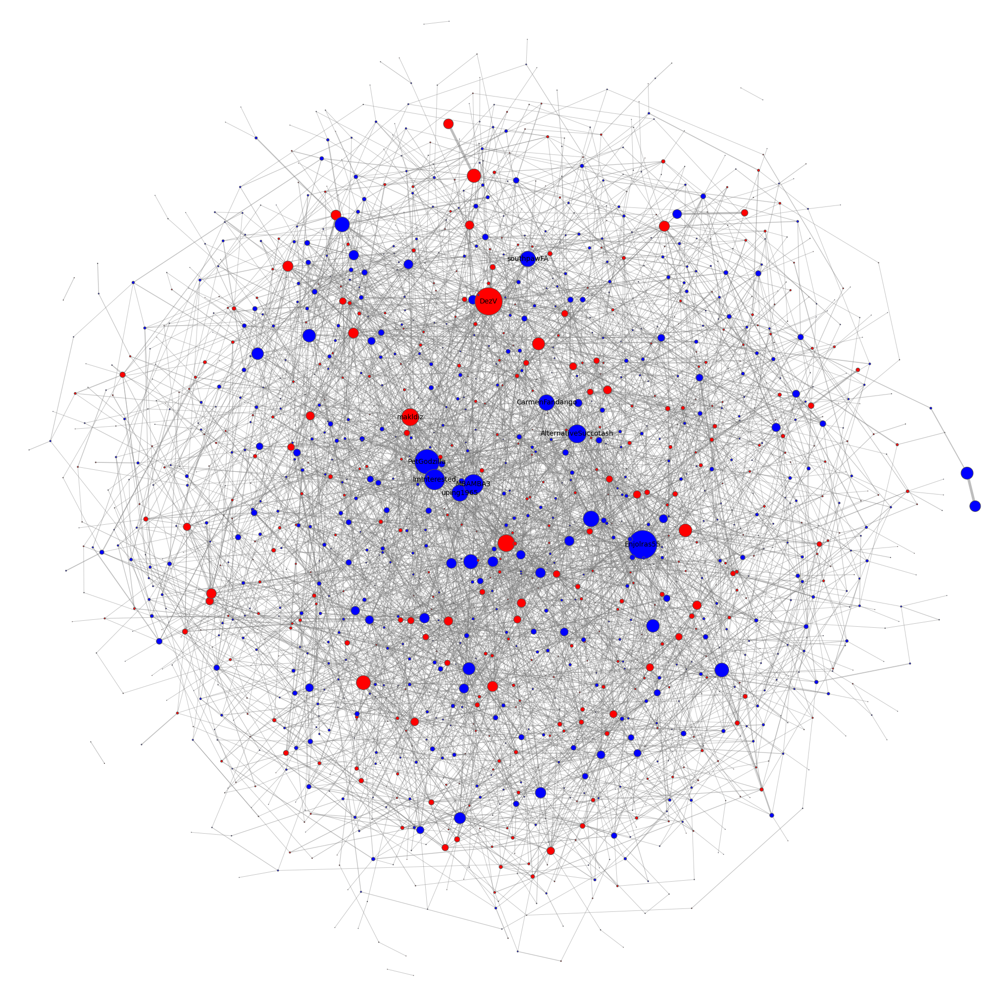

In [333]:
#nx.write_gexf(G_U, "com_network.gexf")

plt.style.use('default')


configuration = {"zoom": 1.1, "node_charge": -30, "node_gravity": 0.4,
                 "link_distance": 15, "link_distance_variation": 0, "node_collision": True,
                 "wiggle_nodes": False, "freeze_nodes": False,
                 "node_fill_color": '#79aaa0', "node_stroke_color": "#555555",
                 "node_label_color": "#000000","node_size": 12,"node_stroke_width": 0.4,
                 "node_size_variation": 1, "label_size": 10, "display_node_labels": False,
                 "scale_node_size_by_strength": True,"link_color": "#7c7c7c", "link_width": 2,
                 "link_alpha": 0.5, "link_width_variation": 0.5, "display_singleton_nodes": False,
                 "min_link_weight_percentile": 0,"max_link_weight_percentile": 1}


network, config = nw.visualize(G_U, plot_in_cell_below=False, config = configuration)

fig, ax = nw.draw_netwulf(network, figsize = 20)

for label in largest_degree_labels: 
    nw.add_node_label(ax,network,label)
    
plt.savefig('submissions_per_day_big.png', bbox_inches='tight')

#with plt.style.context('classic'):
 #  network, config = nw.interactive.visualize(nw.get_filtered_network(G_U, node_group_key='conviction'),  plot_in_cell_below=False)
  # fig, ax = nw.draw_netwulf(network, config = configuration)


----------------------------------------
Exception happened during processing of request from ('127.0.0.1', 63796)
Traceback (most recent call last):
  File "C:\Shared\anaconda3\lib\socketserver.py", line 316, in _handle_request_noblock
    self.process_request(request, client_address)
  File "C:\Shared\anaconda3\lib\socketserver.py", line 347, in process_request
    self.finish_request(request, client_address)
  File "C:\Shared\anaconda3\lib\socketserver.py", line 360, in finish_request
    self.RequestHandlerClass(request, client_address, self)
  File "C:\Shared\anaconda3\lib\http\server.py", line 647, in __init__
    super().__init__(*args, **kwargs)
  File "C:\Shared\anaconda3\lib\socketserver.py", line 720, in __init__
    self.handle()
  File "C:\Shared\anaconda3\lib\http\server.py", line 427, in handle
    self.handle_one_request()
  File "C:\Shared\anaconda3\lib\http\server.py", line 415, in handle_one_request
    method()
  File "C:\Shared\anaconda3\lib\http\server.py", line 6

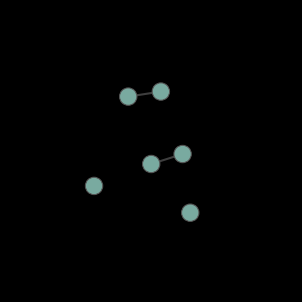

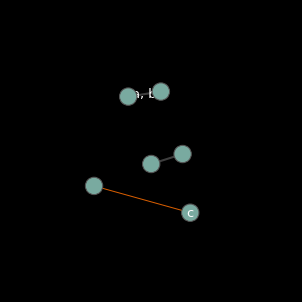

In [298]:
G = nx.Graph()
G.add_nodes_from([0,1,2,'a','b','c'])
G.add_edges_from([(0,1),('a','b')])

network, config = nw.visualize(G,config={'zoom':3})

# draw links only at first
fig, ax = nw.draw_netwulf(network,draw_nodes=False)

# get positions of two unconnected nodes to draw a link anyway
v0 = nw.node_pos(network, 'c')
v1 = nw.node_pos(network, 2)
ax.plot([v0[0],v1[0]],[v0[1],v1[1]],c='#d95f02')

# draw nodes now
nw.draw_netwulf(network,fig,ax,draw_links=False)

# add labels to a node and an edge
nw.add_node_label(ax,network,'c')
nw.add_edge_label(ax,network,('a','b'))

In [273]:
L = len(G_U.edges)
N = len(G_U.nodes)
p = 2*L/(N*(N-1))
print(f'p={p * 100:.2f}%')
k = 2*L/N
print('k: {:.3f}'.format(k))

p=0.33%
k: 5.067


In [274]:
Random_graph = nx.generators.random_graphs.erdos_renyi_graph(N,p)

minDeg: 0 | maxDeg: 16


Text(0.5, 0, 'degrees')

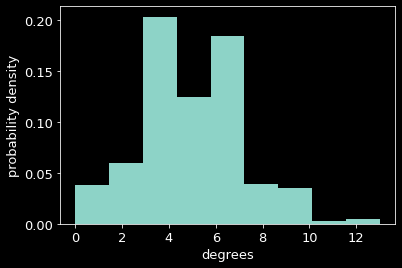

In [275]:
#Degree distribution for random network:

degrees = [x[1] for x in Random_graph.degree]
print('minDeg: {} | maxDeg: {}'.format(min(degrees), max(degrees)))
bins = np.linspace(0, 13, 10)
hist, edges = np.histogram(degrees, bins=bins, density=True)
x = (edges[1:]+edges[:-1])/2
width = bins[1] - bins[0]
plt.style.use('dark_background')
fig, ax = plt.subplots()
ax.bar(x, hist, width=width)
ax.set_ylabel("probability density")
ax.set_xlabel("degrees")

minDeg: 0 | maxDeg: 57


Text(0.5, 0, 'degrees')

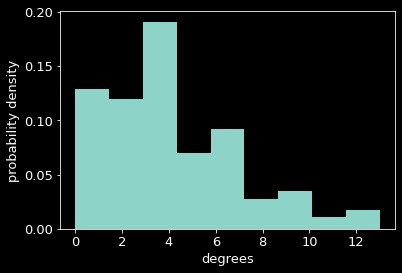

In [272]:
#Degree distribution for random network:

degrees = [x[1] for x in G_U.degree]
print('minDeg: {} | maxDeg: {}'.format(min(degrees), max(degrees)))
bins = np.linspace(0, 13, 10)
hist, edges = np.histogram(degrees, bins=bins, density=True)
x = (edges[1:]+edges[:-1])/2
width = bins[1] - bins[0]
plt.style.use('dark_background')
fig, ax = plt.subplots()
ax.bar(x, hist, width=width)
ax.set_ylabel("probability density")
ax.set_xlabel("degrees")

minDeg: 0 | maxDeg: 57


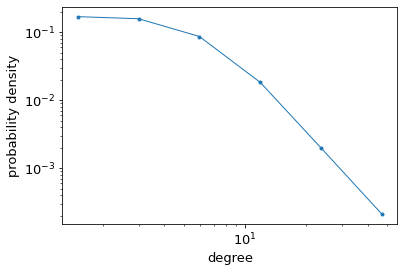

In [271]:
#Degree distribution for the reddit network:
degReddit = [x[1] for x in G_U.degree]
print('minDeg: {} | maxDeg: {}'.format(min(degReddit), max(degReddit)))
bins_reddit = np.logspace(0, np.log10(498), 10)
hist_reddit, edges_reddit = np.histogram(degReddit, bins=bins_reddit, density=True)
x_reddit = (edges_reddit[1:]+edges_reddit[:-1])/2
fig, ax = plt.subplots()
xx, yy = zip(*[(i,j) for (i,j) in zip(x_reddit, hist_reddit) if j > 0])
ax.plot(xx, yy, marker='.')
ax.set_ylabel("probability density")
ax.set_xlabel("degree")
ax.set_yscale('log')
ax.set_xscale('log')


# 4 Discussion

### What is still missing?

### What could be improved?

It would undoubtedly have been interesting to investigate the political content on r/politics over a longer time period, e.g. six months preceeding the election day, which would allow for the detection of longer term trends in redditor activity and sentiment. For such a scope to be feasible, bigger computational muscles than what the group members had at their disposal. 